In [1]:
library(data.table) # for faster reading of big tables, like this one
library(caTools)
library(caret)

Loading required package: lattice
Loading required package: ggplot2


### Load Data

In [2]:
train <- read.csv("train_clean.csv", stringsAsFactors=TRUE) 
test <- read.csv("test_clean.csv", stringsAsFactors=TRUE)

# select top features
boruta_vars = c('var38', 'var15', 'num_var37_med_ult2', 'num_var37_0', 'saldo_var5', 'saldo_var30', 'saldo_var37', 'saldo_var42',
               'num_var22_hace3', 'num_var22_ult3', 'num_med_var45_ult3', 'num_meses_var5_ult3', 'num_var45_hace2',
               'num_var45_hace3', 'num_var45_ult3', 'saldo_medio_var5_hace2', 'saldo_medio_var5_ult1', 'saldo_medio_var5_ult3',
               'no0')

train = train[,boruta_vars]
test = test[,boruta_vars]

dim(train)
dim(test)

[1] 76020    19

[1] 75818    19

In [3]:
train_target = read.csv("train.csv", stringsAsFactors=FALSE)$TARGET
train$target = train_target

In [4]:
head(train)

,var38,var15,num_var37_med_ult2,num_var37_0,saldo_var5,saldo_var30,saldo_var37,saldo_var42,num_var22_hace3,num_var22_ult3,num_med_var45_ult3,num_meses_var5_ult3,num_var45_hace2,num_var45_hace3,num_var45_ult3,saldo_medio_var5_hace2,saldo_medio_var5_ult1,saldo_medio_var5_ult3,no0,target
1,39205.17,23,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,355,0
2,49278.03,34,0,0,0,300,0,0,0,0,0,1,0,0,0,0,0,0,329,0
3,67333.77,23,0,0,3,3,0,3,0,0,0,3,0,0,0,3,3,2.07,340,0
4,64007.97,37,6,6,70.62,70.62,34.95,70.62,0,3,15,2,27,3,48,186.09,91.56,138.84,309,0
5,117311,39,0,0,0,135003,0,135003,0,9,0,3,0,0,0,3,40501.08,13501.47,319,0
6,87975.75,23,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,355,0


### Find correlated features

In [5]:
# select a smaller dataset to speed up analysis
set.seed(144)
spl = sample.split(train$target, SplitRatio = 0.2) # choose 20% of rows
train_small = subset(train, spl == T)
dim(train_small)

[1] 15204    20

In [6]:
# remove target variable and index
train_small$target = NULL

### Feature Correlation Analysis

In [7]:
# Correlation of variables
M = abs(cor(train_small)) # remove index and target variable
diag(M) = 0

# Find those columns that are highly correlated
highcor = which(M > 0.7, arr.ind = TRUE)
head(highcor)

,row,col
num_var37_0,4,3
num_var37_med_ult2,3,4
saldo_medio_var5_ult1,17,5
saldo_var42,8,6
saldo_var30,6,8
num_var22_ult3,10,9


In [8]:
dim(highcor)

[1] 22  2

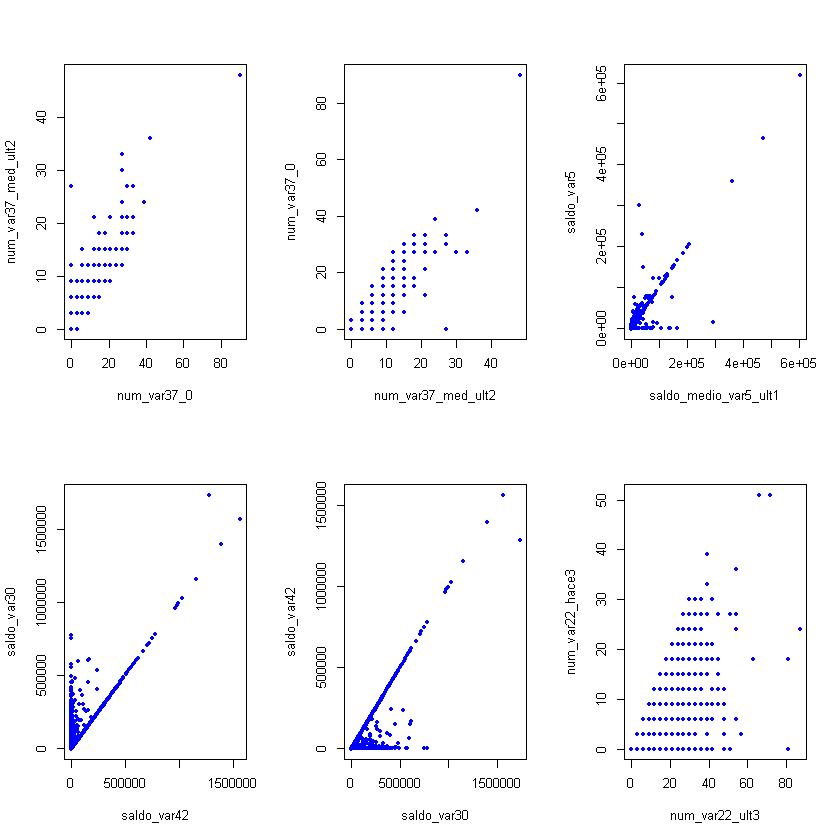

In [9]:
# DO NOT RUN IF IT IS TOO MANY CORRELATED FEATURES BECAUSE IT CRASHES!!!
par(mfrow = c(2, 3))
for (i in 1:6)  {# replace by dim(highcor)[1] if not too many correlated features
  plot(train_small[,highcor[i,1]], train_small[,highcor[i,2]], xlab = names(train_small)[highcor[i,]][1], 
       ylab = names(train_small)[highcor[i,]][2], col = 'blue', pch = 20)
  }

In [10]:
# to have a visual idea of the correlated features
sort(highcor)

[1]  3  3  4  4  5  5  6  6  8  8  9  9 10 10 11 11 11 11 11 11 13 13 13 13 14
[26] 14 14 14 15 15 15 15 15 15 16 16 17 17 17 17 18 18 18 18

### Remove correlated features

In [11]:
hc = findCorrelation(M, cutoff=0.7) # Mind that M is absolute value (independent of negative correlation)
hc = sort(hc)
hc

[1]  4  6 10 11 15 17 18

In [12]:
reduced_train = train_small[,-c(hc)]
dim(reduced_train)
head(reduced_train)

[1] 15204    12

,var38,var15,num_var37_med_ult2,saldo_var5,saldo_var37,saldo_var42,num_var22_hace3,num_meses_var5_ult3,num_var45_hace2,num_var45_hace3,saldo_medio_var5_hace2,no0
1,39205.17,23,0,0,0,0,0,0,0,0,0,355
7,94956.66,27,0,3,0,3,0,3,0,0,3,340
9,101962,45,0,0,0,0,0,0,0,0,0,355
12,75368.52,26,0,0,0,0,0,0,0,0,0,355
14,118437,43,0,0,0,120000,3,3,12,12,120000,313
15,95294.13,33,3,0,264.57,3358.74,6,2,6,9,633.87,275


In [13]:
# variables kept after correlated feature removal
colnames(reduced_train)

[1] "var38"                  "var15"                  "num_var37_med_ult2"    
 [4] "saldo_var5"             "saldo_var37"            "saldo_var42"           
 [7] "num_var22_hace3"        "num_meses_var5_ult3"    "num_var45_hace2"       
[10] "num_var45_hace3"        "saldo_medio_var5_hace2" "no0"

In [23]:
train = train[,colnames(reduced_train)]
test = test[,colnames(reduced_train)]

write.csv(train, 'train_nonCorr.csv', row.names=FALSE)
write.csv(test, 'test_nonCorr.csv', row.names=FALSE)